# 8. Előadás: Objektum detekció

## Könyvtárak

In [1]:
import pandas as pd
import numpy as np
import random as rnd
import seaborn as sns
import tarfile
import cv2
import itertools
import matplotlib.pyplot as plt
import warnings

import torch
import torch.utils.data
import torchvision
from torchvision import transforms
from PIL import Image, ImageFile
from google.colab.patches import cv2_imshow

warnings.simplefilter(action='ignore')
ImageFile.LOAD_TRUNCATED_IMAGES=True

## Adatkészlet

In [2]:
from google.colab import drive
drive.mount('/content/drive')
#drive.mount("/content/drive", force_remount=True)

Mounted at /content/drive


#### Előfeldolgozás

In [3]:
# Előfeldolgozási függvények
im_width = 1235
im_height = 375
img_transforms = transforms.Compose([transforms.ToTensor(),
                                     torchvision.transforms.Resize((im_height, im_width)),
                                     transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])])
                                    

test_data = torchvision.datasets.ImageFolder(root='/content/drive/MyDrive/training/images/', transform=img_transforms)

Adatbetöltők létrehozása

In [4]:
batch_size = 2
test_data_loader = torch.utils.data.DataLoader(test_data, batch_size=batch_size)

In [5]:
if torch.cuda.is_available():
    device = torch.device('cuda')
else:
    device = torch.device('cpu')

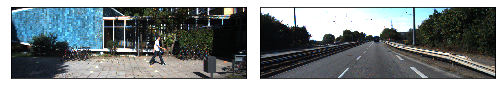

In [6]:
# Adatbetöltők kipróbálása
def display_img(img, show=True):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)), interpolation='none')
    if show:
        plt.show()

# Képek mutatása egy hálón
def img_grid(image):
    plt.figure(figsize=(14, 12))
    for i in range(0, batch_size):
        plt.subplot(6,4,i+1)
        grid_data = image[i]
        display_img(grid_data, show=False)
        plt.xticks([])
        plt.yticks([])
    plt.tight_layout()

image, label = next(iter(test_data_loader))
img_grid(image)

In [7]:
# Predikciós címkék
classes = ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']

columns = ['Type', 'Truncated', 'Occluded', 'Alpha', 'Left', 'Top', 'Right', 'Bottom', 'Height', 'Width', 'Length', 'X', 'Y', 'Z', 'Rotation']

COLORS = {classes[i]:np.random.uniform(0, 255, size=(1, 3)) for i in range(len(classes))}

indices = [x for x in range(len(test_data))]

def get_color(name):
    if name in COLORS.keys():
        return COLORS[name][0]
    else:
        return (1.0, 1.0, 1.0)

In [8]:
# Címkék beolvasása
y_true = {}
for i in range(len(test_data)):
    name = '/content/drive/MyDrive/training/label_2/' + str(str(i).zfill(6)) + '.txt' # File name + path
    piece = pd.read_csv(name, sep= ' ', names=columns)
    piece.drop(['Truncated','Occluded','Alpha','Truncated','Occluded','Alpha','Height','Width','Length','X','Y','Z','Rotation'], axis=1, inplace=True)
    y_true[i] = piece

In [9]:
# Egy kép ábrázolása kereteződobozokkal
def Denormaliser3Channel(image):
    image = np.array(image)
    image = np.transpose(image, (1, 2, 0))
    mean=[0.5, 0.5, 0.5] 
    std=[0.5, 0.5, 0.5]
    image = image * std
    image = image + mean
    image = (image) * 255.
    image = image.round().astype('uint8')             
    return image

def draw_boxes(df, img, colortype=0):
    img = np.array(img)
    image = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    for i in range(len(df)):
        box = [df['Left'][i], df['Top'][i], df['Right'][i], df['Bottom'][i]]
        label = df['Type'][i]
        if (colortype==0):
            color = get_color(label)
        elif (colortype==1):
            color = get_color('Car')
        elif (colortype==2):
            color = get_color('Van')    
        cv2.rectangle(image, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])), color, 2)
        cv2.putText(image, label, (int(box[0]), int(box[1]-5)), cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2, lineType=cv2.LINE_AA)
    return image

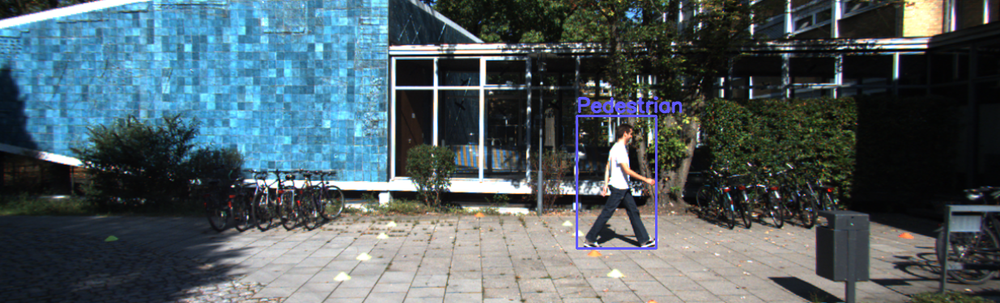

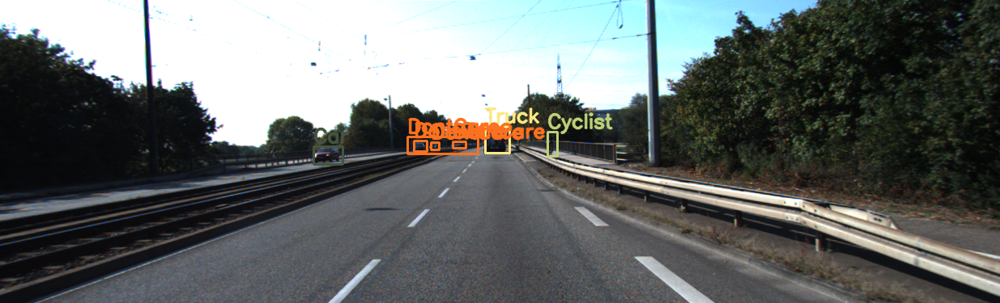

In [10]:
# Kereteződobozok kipróbálása
i = 0 
num_images = 2
for batch in test_data_loader:
    images, labels = batch
    for img in images:
        df = y_true[i]
        img = Denormaliser3Channel(img)
        boxed_img = draw_boxes(df, img)
        cv2_imshow(boxed_img)
        i = i + 1
    if (i >= num_images):
        break

## Modellek

In [11]:
from torchvision.models import detection

nc = len(classes) # Osztályok számossága

models = {  'mask': detection.maskrcnn_resnet50_fpn(pretrained=True, pretrained_backbone=True, progress=True).to(device),
            'mobile': detection.fasterrcnn_mobilenet_v3_large_fpn(pretrained=True, pretrained_backbone=True, progress=True).to(device),
            'retina': detection.retinanet_resnet50_fpn(pretrained=True, pretrained_backbone=True, progress=True).to(device)}

for i in models.keys():
    print(i)
    models[i].eval()
    #print(models[i])

Downloading: "https://download.pytorch.org/models/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth" to /root/.cache/torch/hub/checkpoints/maskrcnn_resnet50_fpn_coco-bf2d0c1e.pth


  0%|          | 0.00/170M [00:00<?, ?B/s]

Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_fpn-fb6a3cc7.pth


  0%|          | 0.00/74.2M [00:00<?, ?B/s]

Downloading: "https://download.pytorch.org/models/retinanet_resnet50_fpn_coco-eeacb38b.pth" to /root/.cache/torch/hub/checkpoints/retinanet_resnet50_fpn_coco-eeacb38b.pth


  0%|          | 0.00/130M [00:00<?, ?B/s]

mask
mobile
retina


In [12]:
# Osztály -> címke leképezés
class_labels = pd.read_csv('/content/drive/MyDrive/training/coco_labels.txt', names=['class'])
class_labels = {i:x.capitalize() for i,x in enumerate(class_labels['class'])}

1. Masknet-RCNN RESNET50 gerinccel: pontosabb, de lassabb
2. Gyorsabb R-CNN MobileNet v3 gerinchálózattal: gyorsabb, de kevésbé pontos.
3. RetinaNet egy ResNet50 gerinchálózattal: jó egyensúly a sebesség és a pontosság között.

### Modellek architektúrája

In [13]:
# Ez a függvény a gépi tanulási modellek előrejelzéseit egy használható pandas DataFrame-be alakítja át
class_map = {3: 'Car', 8: 'Van', 8: 'Truck', 1: 'Pedestrian', 1: 'Person_sitting', 2: 'Cyclist', 7: 'Tram', -1: 'Misc', -1: 'DontCare'}

def get_class(label):
    if label in class_map.keys():
        return class_map[label]
    else:
        return class_map[-1]

def predtodf(detections):
    cols = ['Type', 'Left', 'Top', 'Right', 'Bottom', 'Score']
    result = pd.DataFrame(columns=cols)
    boxes = detections['boxes'].cpu().detach().numpy()
    labels = detections['labels'].cpu().detach().numpy()
    scores = detections['scores'].cpu().detach().numpy()
    for i in range(len(boxes)):
        pred_type = get_class(labels[i])
        piece = pd.DataFrame({'Type': [pred_type], 'Left': [boxes[i][0]], 'Top': [boxes[i][1]],
                            'Right': [boxes[i][2]], 'Bottom': [boxes[i][3]], 'Score': [scores[i]]})
        result = pd.concat([result, piece], axis=0, ignore_index=True, sort=False)
    return result

In [14]:
# Modell tesztelése egy képen
image = cv2.imread('/content/drive/MyDrive/training/images/image_2/000007.png')
orig = image.copy()
image = image.transpose((2, 0, 1))
image = np.expand_dims(image, axis=0)
image = image / 255.0
image = torch.FloatTensor(image)
image = image.to(device)
model = models['mobile']
detections = model(image)[0]
predtodf(detections)

,Type,Left,Top,Right,Bottom,Score
0,Car,563.368713,175.562775,610.349365,219.999634,0.712957
1,Car,968.115723,174.213211,1025.612793,192.190765,0.552043
2,Car,548.976379,175.674850,571.799805,194.462341,0.534129
3,Car,970.471741,177.842484,1031.419067,203.789856,0.456322
4,Car,479.473267,181.809616,512.760376,198.934021,0.363276
5,Car,541.159790,176.060837,556.735901,189.995331,0.353183
6,Person_sitting,333.595825,175.282791,358.871704,210.938568,0.310495
7,Person_sitting,333.327942,178.743484,348.621155,207.370941,0.288719
8,DontCare,1217.810791,61.363918,1242.000000,136.991806,0.287013
9,Car,1012.780823,178.496506,1052.787964,202.100677,0.234334


In [15]:
# Függvény, amely paraméterként egy modellt vesz fel, és az egyes képek határoló dobozaihoz tartozó DataFrame-ek diktafonját adja vissza.
def create_predictions(model_name):
    model = models[model_name]
    model = model.to(device)
    ind_count = 0
    result = {}
    for batch in test_data_loader: # Iteráció a tesztadatok betöltőjén, majd predikció
        images, targets = batch
        images = images.to(device)
        with torch.no_grad():
            output = model(images)
            for i in range(len(output)): # Iteráció a kötegeken
                out_res = output[i]
                df = predtodf(out_res)
                result[ind_count] = df
                ind_count = ind_count + 1
                print('Processing image: ' + str(ind_count), end='\r')
            del output
    return result

In [16]:
mask_out = create_predictions('mask')

In [17]:
mobile_out = create_predictions('mobile')

In [18]:
retina_out = create_predictions('retina')

In [19]:
# Valós címkék beolvasása
for model, name in zip([mask_out, mobile_out, retina_out], models.keys()):
    for i in range(len(model)):
        outfile = '/content/drive/MyDrive/preds/' + str(name) + '/' + name +'_out_' + str(i) + '.csv'
        df = model[i]
        df.to_csv(outfile, sep=';', header=True, index=False)

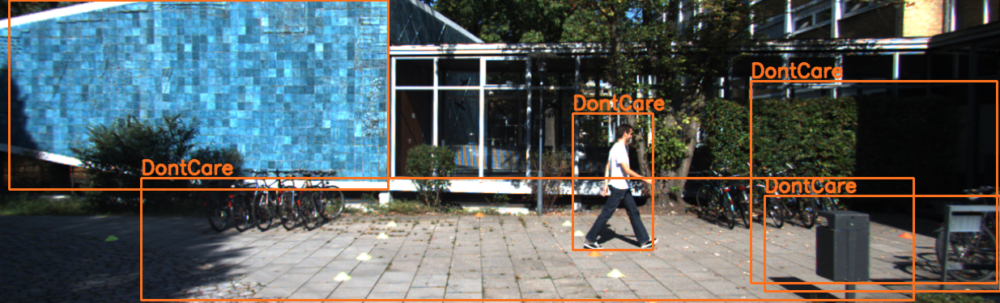

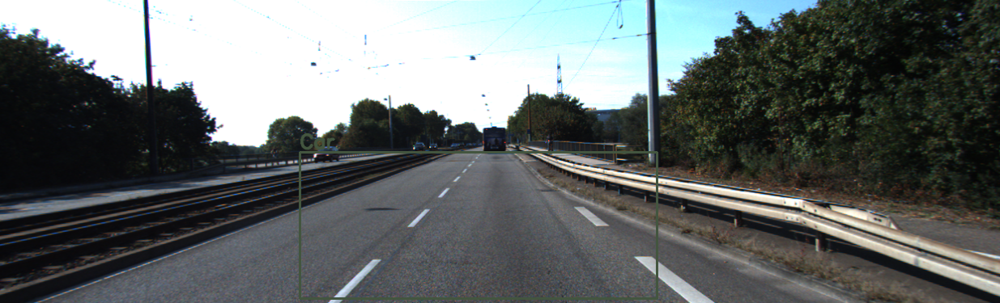

In [20]:
# Mobilenet predikcióinak vizsgálata
i = 0 
num_images = 2
for batch in test_data_loader:
    images, labels = batch
    for img in images:
        df = mobile_out[i]
        if(len(df) == 0):
            break
        img = Denormaliser3Channel(img)
        boxed_img = draw_boxes(df, img)
        cv2_imshow(boxed_img)
        i = i + 1
    if (i >= num_images):
        break

## Kiértékelés

In [21]:
# Téglalap osztály
class Rectangle:
    def intersection(self, other):
        a, b = self, other
        x1 = max(min(a.x1, a.x2), min(b.x1, b.x2))
        y1 = max(min(a.y1, a.y2), min(b.y1, b.y2))
        x2 = min(max(a.x1, a.x2), max(b.x1, b.x2))
        y2 = min(max(a.y1, a.y2), max(b.y1, b.y2))
        if x1<x2 and y1<y2:
            return type(self)(x1, y1, x2, y2)

    __and__ = intersection # Téglalapok metszetének operátora

    def difference(self, other):
        inter = self&other
        if not inter:
            yield self
            return
        xs = {self.x1, self.x2}
        ys = {self.y1, self.y2}
        if self.x1<other.x1<self.x2: xs.add(other.x1)
        if self.x1<other.x2<self.x2: xs.add(other.x2)
        if self.y1<other.y1<self.y2: ys.add(other.y1)
        if self.y1<other.y2<self.y2: ys.add(other.y2)
        for (x1, x2), (y1, y2) in itertools.product(pairwise(sorted(xs)), pairwise(sorted(ys))):
            rect = type(self)(x1, y1, x2, y2)
            if rect!=inter:
                yield rect

    __sub__ = difference # Kivonás operátor
    
    def __init__(self, x1, y1, x2, y2):
        if x1>x2 or y1>y2:
            raise ValueError("Coordinates are invalid")
        self.x1, self.y1, self.x2, self.y2 = x1, y1, x2, y2
    
    def __iter__(self):
        yield self.x1
        yield self.y1
        yield self.x2
        yield self.y2
    
    def __eq__(self, other):
        return isinstance(other, Rectangle) and tuple(self)==tuple(other)
    
    def __ne__(self, other):
        return not (self==other)
    
    def __repr__(self):
        return type(self).__name__+repr(tuple(self))

def pairwise(iterable):
    a, b = itertools.tee(iterable)
    next(b, None)
    return zip(a, b)

def rect_size(R): # Téglalap mérete
    return (R.x2 - R.x1) * (R.y2 - R.y1)

def rects_diff(R_lst): # Különbözet téglalap mérete
    sum = 0
    for R in R_lst:
        sum = sum + rect_size(R)
    return sum

def IOU(R1, R2): # IOU
    if (R1 & R2 is None):
        return 0
    else:
        intersect = rect_size(R1 & R2)
        union = (rect_size(R1) - intersect) + rect_size(R2)
        return intersect / union

In [22]:
# Egy DataFrame átalakítása bbox téglalapok listájává
def get_rectangles(df): 
    rects = []
    for i in range(len(df)):
        row = df.iloc[i, :]
        new_bottom = im_height - row['Bottom']
        new_top = im_height - row['Top']
        #print(row['Left'], new_bottom, row['Right'], new_top)
        rects.append(Rectangle(row['Left'], new_bottom, row['Right'], new_top))
    return rects

In [23]:
# Igaz pozitív / hamis pozitív hozzárendelése a predikciós struktúrához
def process_output(out, y_true):
    output = out
    proc_true = y_true
    for i in range(len(proc_true)):
        rect_true = get_rectangles(proc_true[i])
        rect_pred = get_rectangles(output[i])

        output[i]['Pred'] = ['' for x in range(len(output[i]))]
        output[i]['IOU'] = [0 for x in range(len(output[i]))]
        proc_true[i]['Pred'] = ['' for x in range(len(proc_true[i]))]

        for j in range(len(rect_true)): # GT iteráció
            R_true = rect_true[j]
            max_iou = 0
            max_ind = -1
        
            for k in range(len(rect_pred)): # Iteráció a predikciókon
                R_pred = rect_pred[k]
                iou = IOU(R_true, R_pred)
                if (iou > max_iou):
                    max_iou = iou
                    max_ind = k
            
            if (max_iou > 0.5 and output[i].loc[max_ind, 'IOU'] < max_iou): # TP
                output[i].loc[max_ind, 'Pred'] = 'TP'
                output[i].loc[max_ind, 'Type'] = proc_true[i].loc[j, 'Type']
                output[i].loc[max_ind, 'IOU'] = max_iou

            if (max_iou > 0.2 and output[i].loc[max_ind, 'IOU'] < max_iou): # FP
                output[i].loc[max_ind, 'Pred'] = 'FP'
                output[i].loc[max_ind, 'Type'] = proc_true[i].loc[j, 'Type']
                output[i].loc[max_ind, 'IOU'] = max_iou
            
            if (max_iou <= 0.2): # A modell nem detektálta a GT címkét -> FN
                proc_true[i].loc[j, 'Pred'] = 'FN'

    return output, proc_true

### Outputok feldolgozása

In [24]:
proc = {}
proc_true = {}
for k, outfile in zip(models.keys(), [mask_out, mobile_out, retina_out]):
    output, out_true = process_output(outfile, y_true)
    proc[k] = outfile
    proc_true[k] = out_true

### Precision

In [26]:
def calc_prec(output):
    TP = 0
    FP = 0
    for i in range(len(output)):
        df = output[i]
        TP += len(df[df['Pred'] == 'TP'])
        FP += len(df[df['Pred'] == 'FP'])
    return TP / (TP + FP)

### Recall

In [27]:
def calc_recall(output, proc_true):
    TP = 0
    FN = 0
    for i in range(len(output)):
        df_out = output[i]
        for j,k in zip(df_out['Pred'], df_out['Type']):
            if (j == 'TP' and k != 'DontCare' and k != 'Misc'):
                TP += 1
        df_true = proc_true[i]
        for j,k in zip(df_true['Pred'], df_true['Type']):
            if (j == 'FN' and k != 'DontCare' and k != 'Misc'):
                FN += 1
    return TP / (TP + FN )

### Átlagos IOU

In [28]:
def calc_miou(output):
    class_dict = {x: [0, 0] for x in classes}
    for i in range(len(output)):
        df = output[i]
        for label,pred,iou in zip(df['Type'], df['Pred'], df['IOU']):
            if (label != 'DontCare' and label != 'Misc' and pred == 'TP'):
                class_dict[label][0] += iou
                class_dict[label][1] += 1

    return {k:(class_dict[k][0]/class_dict[k][1]) for k in class_dict.keys() if k != 'DontCare' and k != 'Misc'}

In [29]:
metrics = pd.DataFrame(index=list(models.keys())) # Metrikák

metrics['Precision'] = [calc_prec(proc[key]) for key in proc.keys()] # Precision mindegyik modellre

metrics['Recall'] = [calc_recall(proc[key], proc_true[key]) for key in proc.keys()] # Recall mindegyik modellre

metrics['MIOU'] = [calc_miou(proc[key]) for key in proc.keys()] # Átlagos IOU mindegyik modellre

## Metrikák ábrázolása

In [30]:
def get_fn(name, i): # Hány TN szerepel egy képen?
    FN = 0
    df = proc_true[name][i]
    for label, pred in zip(df['Type'], df['Pred']):
        if (label!='DontCare' and label!='Misc' and pred=='FN'):
            FN+=1
    return FN

def calc_prc(name): # Precision-recall görbe
    output = proc[name]
    cols = ['Image', 'Type', 'Score', 'Pred']
    df = pd.DataFrame(columns = cols)
    for i in range(len(output)):
        piece = output[i].loc[:,['Type', 'Score', 'Pred']]
        piece['Image'] = i
        piece = piece[cols] 
        piece = piece[piece['Pred'].astype(bool)]
        df = pd.concat([df, piece], axis=0, ignore_index=True)
    df = df.sort_values(by='Score', ascending=False)
    onehot = pd.get_dummies(df['Pred'])
    df.drop('Pred', axis=1, inplace=True)
    df = df.join(onehot)
    df['FN'] = [get_fn(name, i) for i in df['Image']]
    df['AccTP'] = np.cumsum(df['TP'])
    df['AccFP'] = np.cumsum(df['FP'])
    df['Precision'] = [tp/(tp+fp) for tp,fp in zip(df['AccTP'], df['AccFP'])] 
    df['Recall'] = [tp/(tp+fn) for tp,fn in zip(df['AccTP'], df['FN'])]
    return df

In [31]:
# Kumulált precision és accuracy mindegyik modellre
ROC_AUC = {'mask': calc_prc('mask'),
           'mobile': calc_prc('mobile'), 
           'retina': calc_prc('retina')}

In [32]:
# Formatálás a kategóriákra
cats = pd.DataFrame(columns=['Class', 'MIOU', 'Model'])
for miou,name in zip(metrics['MIOU'], list(metrics.index)):
    piece = pd.DataFrame(pd.Series(metrics['MIOU'][name]).reset_index())
    piece.columns = ['Class', 'MIOU']
    piece['Model'] = name
    cats = pd.concat([cats, piece], axis=0, ignore_index=True)

### Precision-Recall görbe a modellekre

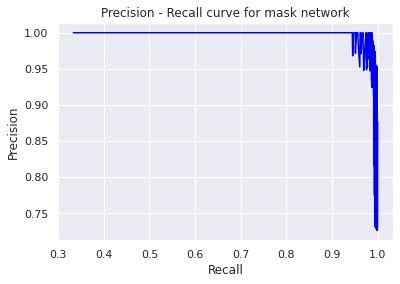

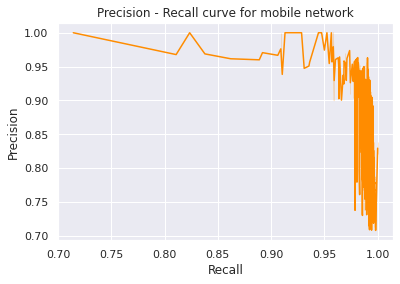

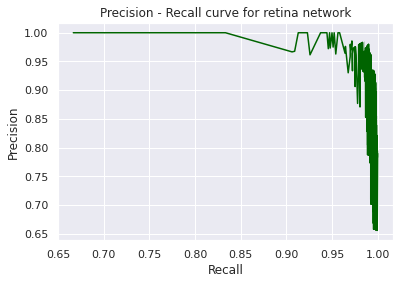

In [33]:
# Precision-recall görbe minden modellre
palette = sns.color_palette("mako_r", 6)
sns.set()
plt_colors = ['blue', 'darkorange', 'darkgreen']
for i,x in enumerate(ROC_AUC.keys()):
    df = ROC_AUC[x]
    plt.title('Precision - Recall curve for ' + x + ' network')
    sns.lineplot(df['Recall'], df['Precision'], color=plt_colors[i])
    plt.show()

### Átlagos IOU

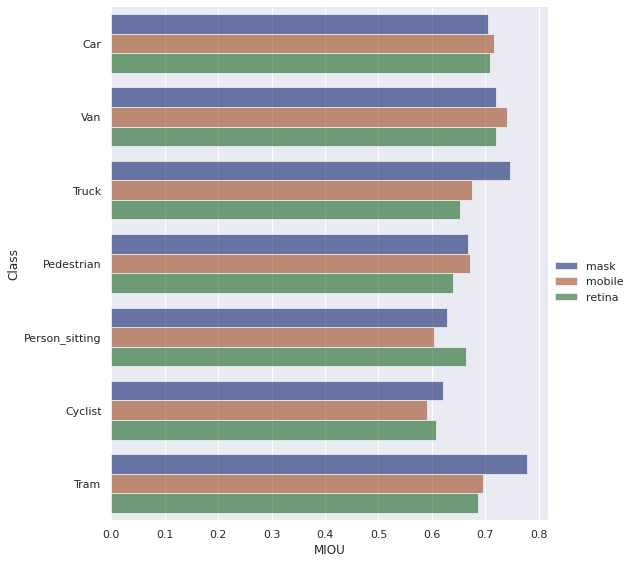

In [34]:
g = sns.catplot(data=cats, kind="bar", x="MIOU", y="Class", hue="Model", ci="sd", palette="dark", alpha=.6, height=8, orient='h')
g.despine(left=True)
g.legend.set_title("")

### Precision és Recall mindegyik modellre

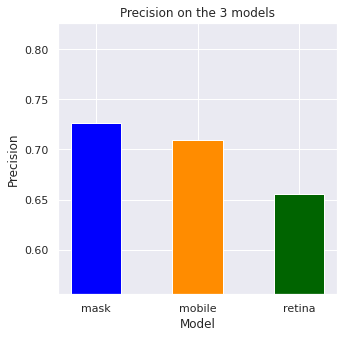

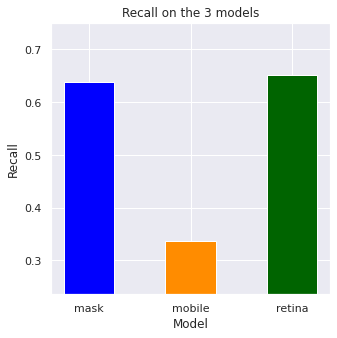

In [35]:
for x in ['Precision', 'Recall']:
    sp = metrics[x]
    plt.figure(figsize=(5,5))
    plt.bar(sp.index, height=sp, align='center', color=plt_colors, width=0.5)
    plt.title(x + ' on the 3 models')
    plt.xlabel('Model')
    plt.ylabel(x)
    plt.ylim([min(sp)-0.1, max(sp+0.1)])
    plt.show()
    print()

## Predikciók megjelenítése

In [36]:
# Függvény ami kirajzol bboxokat
def show_preds(name, num_images, which_batch):
    i = 0 
    icount = 0
    b = 0
    for batch in test_data_loader:
        images, labels = batch
        if (b < which_batch):
            b+=1
            i+=batch_size
            continue 
        else:
            for img in images:
                df_true = y_true[i]
                df_pred = proc[name][i]
                df_pred = df_pred[df_pred['Pred']=='TP'].reset_index().drop('index', axis=1)
                if (len(df_pred) == 0):
                    i+=1
                    continue
                img = Denormaliser3Channel(img)
                true_img = draw_boxes(df_true, img, colortype=1)
                boxed_img = draw_boxes(df_pred, true_img, colortype=2)
                cv2_imshow(boxed_img)
                print()
                i += 1
                icount+=1
            if (icount >= num_images):
                break
            

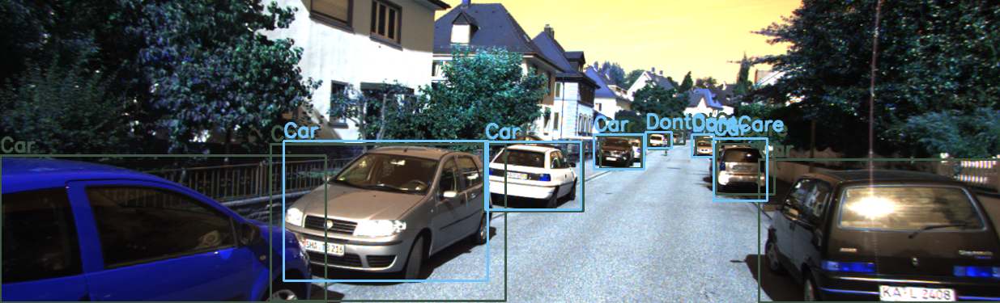

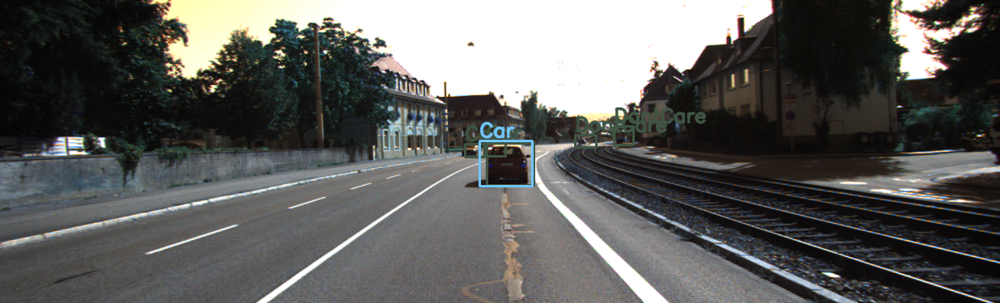

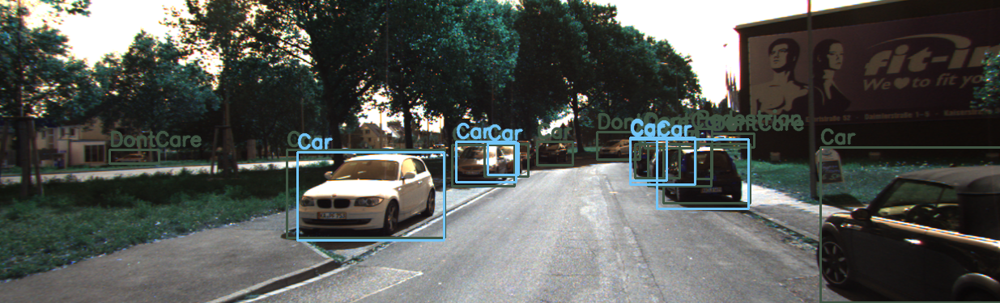

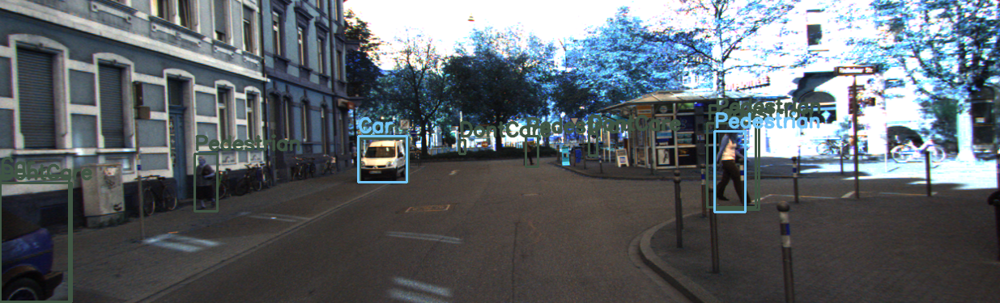

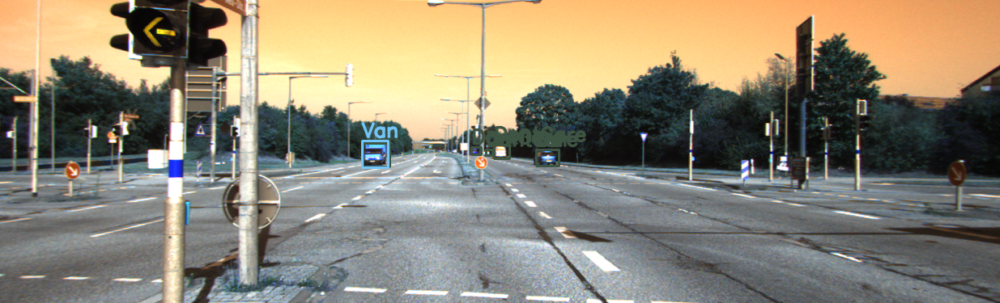

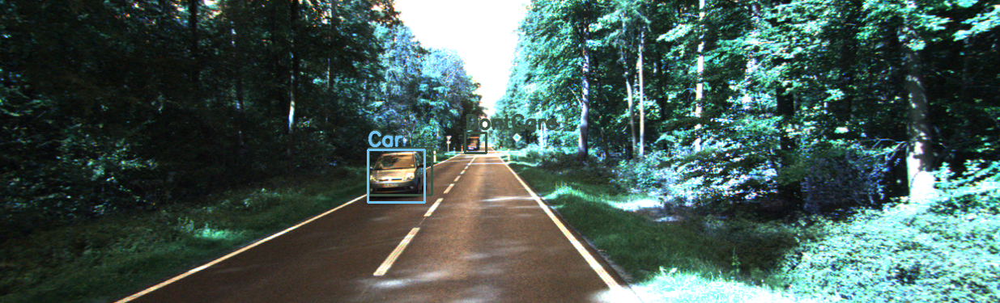

In [37]:
show_preds('mask', num_images=6, which_batch=4)

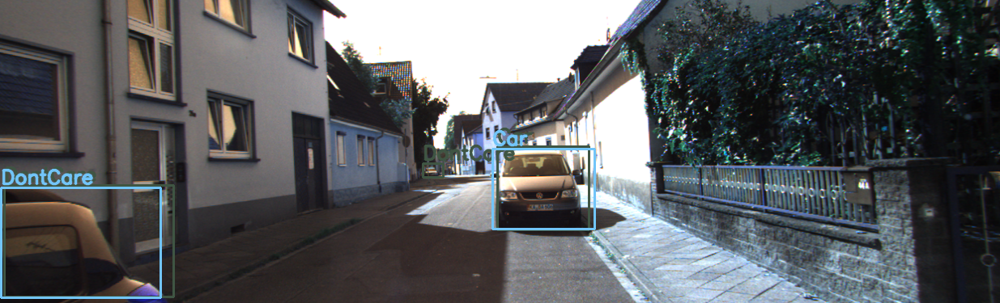

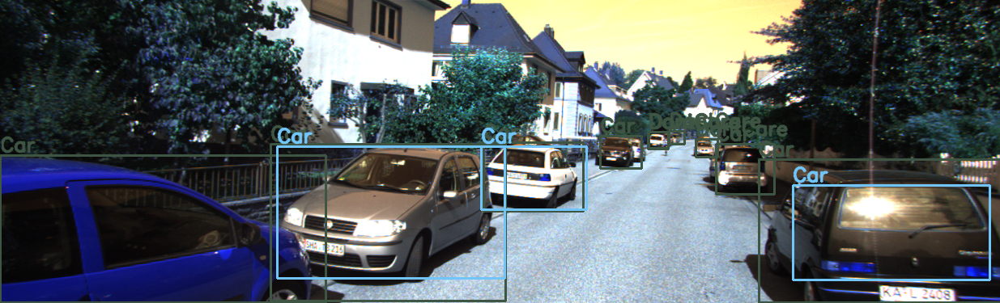

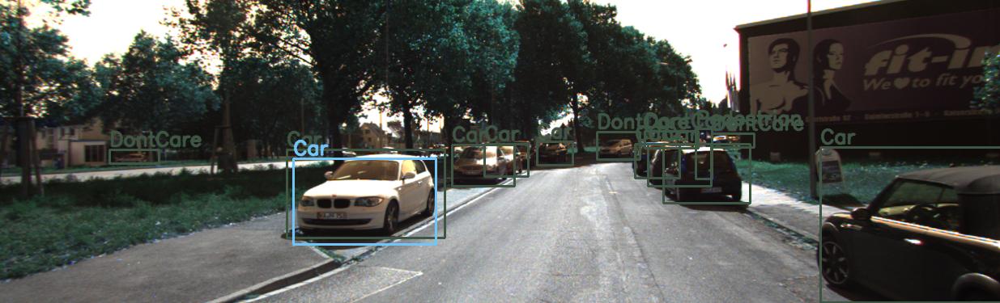

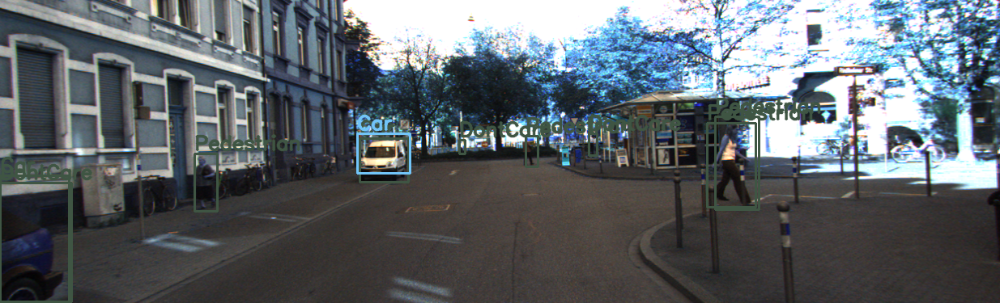

In [38]:
show_preds('mobile', num_images=4, which_batch=1)

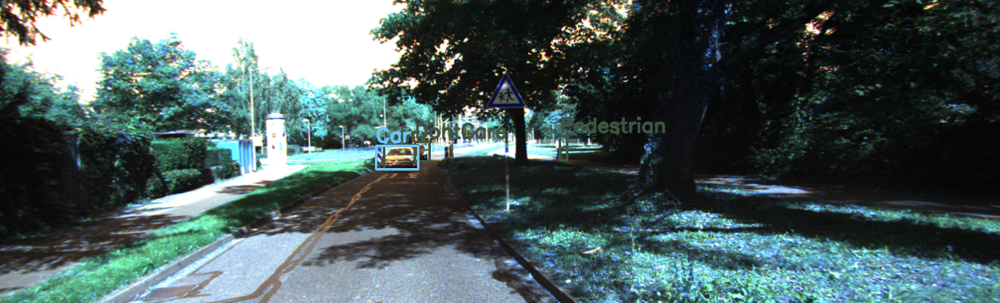

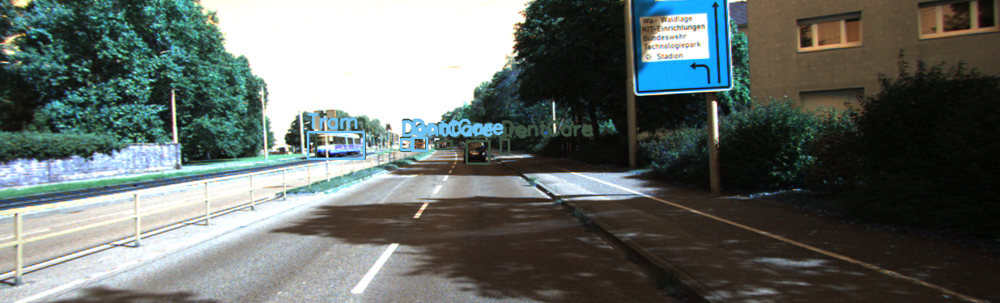

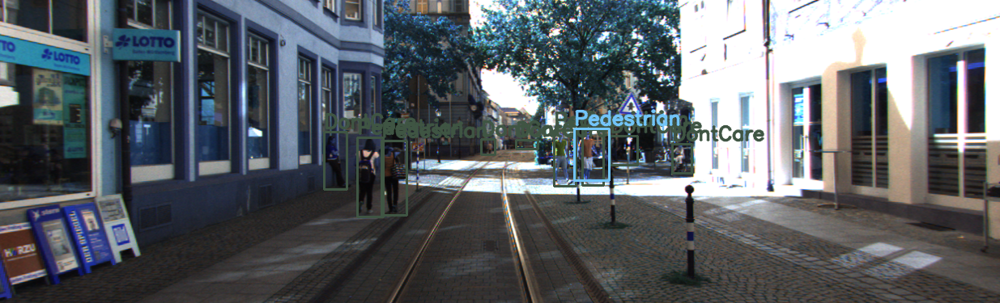

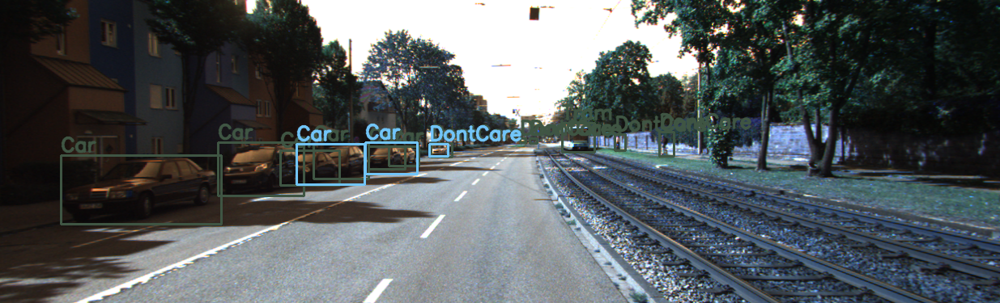

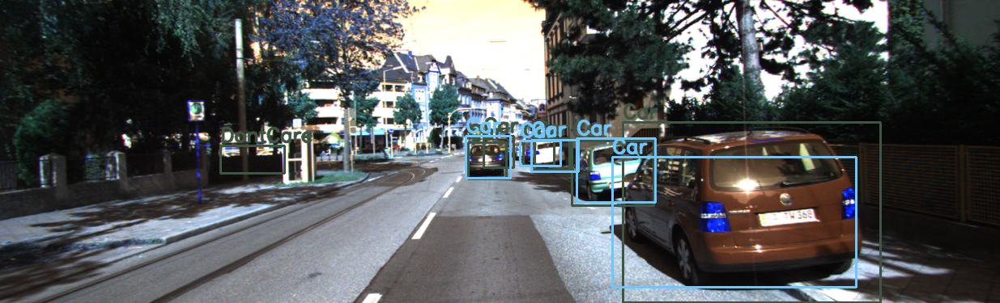

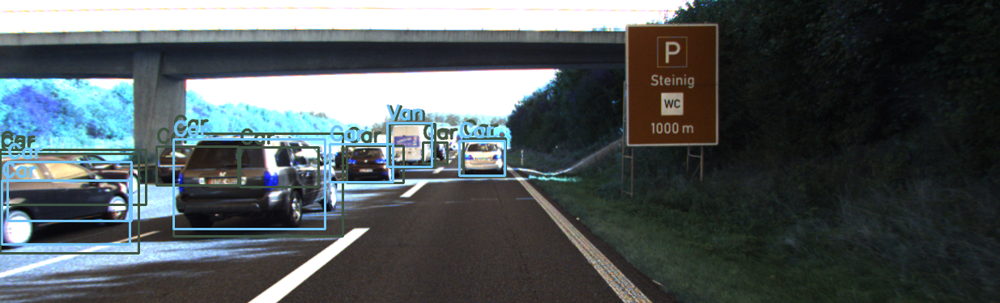

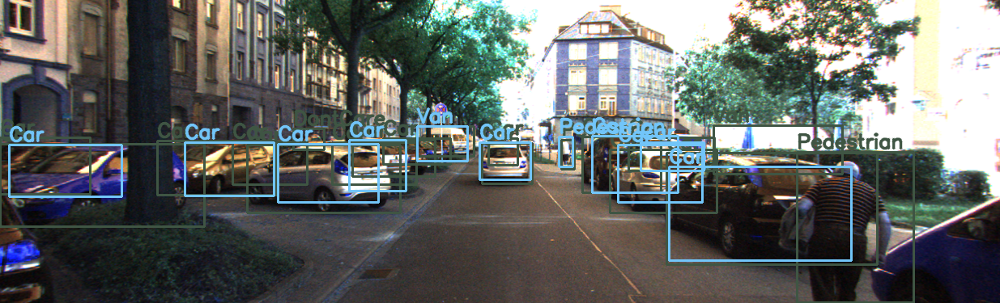

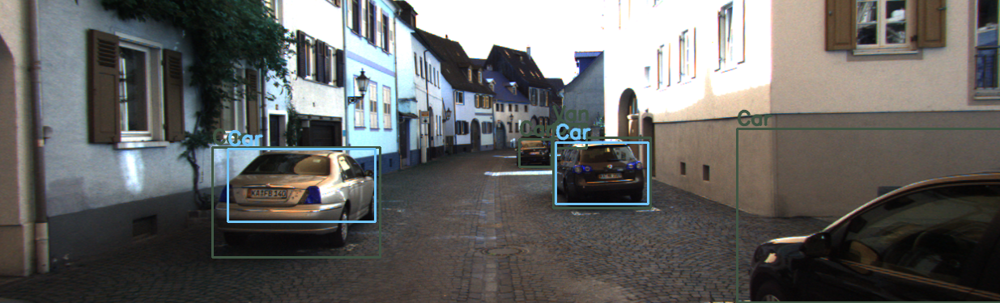

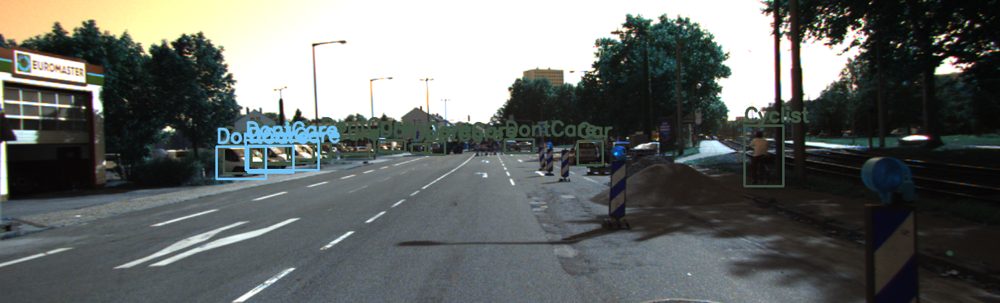

In [39]:
show_preds('retina', num_images=8, which_batch=20)